# VanillaGANs for MNIST dataset #

In [1]:
# Number of workers for training
num_workers = 4
# Batch size during training
batch_size = 512
# Spatial size of training images
image_size = 28 #64
# Number of channels in the training images. For color images this is 3. For grayscale image (e.g. MNIST) is 1.
nc = 1
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Number of training epochs
num_epochs = 20
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5
# Beta2 hyperparam for Adam optimizers
beta2 = 0.999

## Step1. Lightning data module for MNIST dataset ##

In [2]:
import os
import torch
from torch.utils.data import Dataset

from pytorch_lightning import LightningDataModule
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import MNIST
from torchvision import transforms
from typing import Optional

torch.manual_seed(111)

class MNISTDataset(LightningDataModule):
    def __init__(
        self,
        data_path: str,
        batch_size: int = 128,
        num_workers: int = num_workers
        ):
        super().__init__()
        self.data_dir = data_path
        self.transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5), (0.5))])
        self.batch_size = batch_size
        self.num_workers = num_workers

    def setup(self, stage: Optional[str] = None) -> None:
        if stage == 'fit' or stage is None:
            full_data = MNIST(os.getcwd(), train=True,  download=True, transform=self.transform)
            self.train_data, self.val_data = random_split(full_data, [50000, 10000])
        if stage == 'test' or stage is None:
            self.test_data  = MNIST(os.getcwd(), train=False, download=True, transform=self.transform)

    def train_dataloader(self):
        return DataLoader(self.train_data, batch_size=self.batch_size, num_workers=self.num_workers)

    def val_dataloader(self):
        return DataLoader(self.val_data, batch_size=self.batch_size, num_workers=self.num_workers)

    def test_dataloader(self):
        return DataLoader(self.test_data, batch_size=self.batch_size, num_workers=self.num_workers)        
    

## Step2. Generator and Discriminator ##
MNIST data set is normalized to [-1, 1] bacause `Tanh` is used in Generator.

### Generator ###

In [3]:
from torch import nn

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.fc0 = nn.Sequential(
                    nn.Linear(nz, 256),
                    nn.LeakyReLU(0.2)
                    )
        self.fc1 = nn.Sequential(
                    nn.Linear(256, 512),
                    nn.LeakyReLU(0.2)
                    )
        self.fc2 = nn.Sequential(
                    nn.Linear(512, 1024),
                    nn.LeakyReLU(0.2)
                    )
        self.fc3 = nn.Sequential(
                    nn.Linear(1024, 28*28),
                    nn.Tanh()
                    )
    def forward(self, x):
        x = x.view(x.shape[0], -1)
        x = self.fc0(x)
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        x = x.view(-1, 1, image_size, image_size)
        return x

### Discriminator ###

In [4]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.fc0 = nn.Sequential(
                    nn.Linear(image_size*image_size, 1024),
                    nn.LeakyReLU(0.2),
                    nn.Dropout(0.3)
                    )
        self.fc1 = nn.Sequential(
                    nn.Linear(1024, 512),
                    nn.LeakyReLU(0.2),
                    nn.Dropout(0.3)
                    )
        self.fc2 = nn.Sequential(
                    nn.Linear(512, 256),
                    nn.LeakyReLU(0.2),
                    nn.Dropout(0.3)
                    )
        self.fc3 = nn.Sequential(
                    nn.Linear(256, 1),
                    nn.Sigmoid()
                    )
    def forward(self, x):
        x = x.view(-1, image_size*image_size)
        x = self.fc0(x)
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        return x

## VanillaGANs ##

In [5]:
from torch.nn import functional as F
from torch import optim
from torch import Tensor
#from torchmetrics.classification import Accuracy
from pytorch_lightning import LightningModule
from torchvision.utils import make_grid
from torchmetrics.image.fid import FrechetInceptionDistance

class VanillaGANs(LightningModule):
    def __init__(
        self,
        channels: int = nc,
        width: int = image_size,
        height: int = image_size,
        latent_dim: int = nz,
        lr: float = lr,
        b1: float = beta1,
        b2: float = beta2,
        batch_size : int = 128,
        **kwargs
    ):
        super().__init__()
        self.save_hyperparameters()
        self.generator = Generator()
        self.discriminator = Discriminator()

        self.validation_z = torch.randn(64, self.hparams.latent_dim, 1, 1)
        self.validation_z_large = torch.randn(int(1e3), self.hparams.latent_dim, 1, 1)
        self.example_input_array = torch.zeros(2, self.hparams.latent_dim, 1, 1)
        self.generated_images = {}
        self.generated_images_large = {}
        self.generated_images_grid = {}
        self.fid = FrechetInceptionDistance(feature=64).to(self.device)
        
    def forward(self, z):
        return self.generator(z)

    def cross_entropy(self, x, y):
        return F.binary_cross_entropy(x, y)        
    
    def training_step(self, batch, batch_size, optimizer_idx):
        images, _ =  batch

        # real images for FID. If you don't need FID metrics, please comment out.
        if self.global_step == 0:
            images_3ch = images.expand(images.size(0), 3, images.size(2), images.size(3))
            images_3ch = images_3ch[:64].type(torch.uint8).to(self.device)
            self.fid.update(images_3ch, real=True)

        # latent vector
        z = torch.randn(images.shape[0], self.hparams.latent_dim, 1, 1)
        z = z.type_as(images)

        # training the generator
        if optimizer_idx == 0:
            val = torch.ones(images.shape[0], 1)
            val = val.type_as(images)
            logits_G = self.discriminator(self(z))
            loss_G = self.cross_entropy(logits_G, val)

            log = {'train_loss_G': loss_G}
            return {'loss': loss_G, 'logs': log}

        # training the discriminator
        if optimizer_idx == 1:
            val = torch.ones(images.shape[0], 1)
            val = val.type_as(images)
            logits_real = self.discriminator(images)
            loss_real = self.cross_entropy(logits_real, val)

            fake = torch.zeros(images.shape[0], 1)
            fake = fake.type_as(images)
            logits_fake = self.discriminator(self(z).detach())
            loss_fake = self.cross_entropy(logits_fake, fake)
            loss_D = (loss_real + loss_fake)/2.0

            log = {'train_loss_D': loss_D}
            return {'loss': loss_D, 'logs': log}

    def configure_optimizers(self):
        lr = self.hparams.lr
        b1 = self.hparams.b1
        b2 = self.hparams.b2
        
        opt_G = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(b1,b2))
        opt_D = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(b1,b2))

        return [opt_G, opt_D], []

    def training_epoch_end(self, outputs) -> None:
        avg_loss_G = torch.stack( tuple(x[0]['loss'] for x in outputs) ).mean()
        avg_loss_D = torch.stack( tuple(x[1]['loss'] for x in outputs) ).mean()
        self.log('loss_G', {'train': avg_loss_G}) 
        self.log('loss_D', {'train': avg_loss_D})

        # fake images in a grid
        z = self.validation_z.to(self.device)
        sample_images = self(z)
        grid = make_grid(sample_images, nrow=8)
        self.logger.experiment.add_image('generated images', grid, self.current_epoch)
        self.generated_images[self.current_epoch] = sample_images
        self.generated_images_grid[self.current_epoch] = grid

        # fake images
        z_large = self.validation_z_large.to(self.device)
        sample_images_large = self(z_large)
        self.generated_images_large[self.current_epoch] = sample_images_large

        # FID. If you don't need FID metrics, please comment out.
        sample_images_3ch = sample_images.expand(sample_images.size(0), 3, sample_images.size(2), sample_images.size(3)).type(torch.uint8).to(self.device)
        self.fid.update(sample_images_3ch, real=False)
        fid_metrics = self.fid.compute().item()
        self.log('FID', {'FID':fid_metrics})
        print('epoch:', self.current_epoch, 'loss_G:', avg_loss_G, 'loss_D:', avg_loss_D, 'FID:', fid_metrics)

## Step4. Logger ##

In [6]:
from pytorch_lightning.loggers import TensorBoardLogger

logger = TensorBoardLogger(save_dir='./tb_logs/', name = 'VanillaGANs')


%reload_ext tensorboard
%tensorboard --logdir=./tb_logs/

Reusing TensorBoard on port 6006 (pid 29098), started 1:59:14 ago. (Use '!kill 29098' to kill it.)

## Step5. Build & fit model ##

In [7]:
data = MNISTDataset(data_path = './', batch_size=batch_size)
model = VanillaGANs()

In [8]:
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks.progress import TQDMProgressBar

runner = Trainer(max_epochs=num_epochs,
                 gpus=[0], # comment out if you use 'cpu'
                 accelerator='gpu',  # 'cpu' or 'gpu', 'auto'
                 logger=logger, 
                 callbacks=[TQDMProgressBar(refresh_rate=10)])


runner.fit(model, data)

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:446: LightningDeprecationWarning: Setting `Trainer(gpus=[0])` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=[0])` instead.
  rank_zero_deprecation(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/pytorch_lightning/trainer/configuration_validator.py:106: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
Missing logger folder: ./tb_logs/VanillaGANs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type                     | Params | In sizes       | Out sizes     
-

Training: 0it [00:00, ?it/s]

epoch: 0 loss_G: tensor(0.8489, device='cuda:0') loss_D: tensor(0.6042, device='cuda:0') FID: 64.01384735107422
epoch: 1 loss_G: tensor(1.1562, device='cuda:0') loss_D: tensor(0.4627, device='cuda:0') FID: 64.01384735107422
epoch: 2 loss_G: tensor(2.0142, device='cuda:0') loss_D: tensor(0.3197, device='cuda:0') FID: 64.01384735107422
epoch: 3 loss_G: tensor(2.8806, device='cuda:0') loss_D: tensor(0.2868, device='cuda:0') FID: 64.01384735107422
epoch: 4 loss_G: tensor(2.8363, device='cuda:0') loss_D: tensor(0.3123, device='cuda:0') FID: 64.01384735107422
epoch: 5 loss_G: tensor(3.0210, device='cuda:0') loss_D: tensor(0.3431, device='cuda:0') FID: 64.01384735107422
epoch: 6 loss_G: tensor(3.3247, device='cuda:0') loss_D: tensor(0.2724, device='cuda:0') FID: 64.01384735107422
epoch: 7 loss_G: tensor(3.3661, device='cuda:0') loss_D: tensor(0.2668, device='cuda:0') FID: 64.01384735107422
epoch: 8 loss_G: tensor(3.1778, device='cuda:0') loss_D: tensor(0.3175, device='cuda:0') FID: 64.0138473

`Trainer.fit` stopped: `max_epochs=20` reached.


## Step6. Check fake images ##

### Fake images ###

(20, 242, 242)



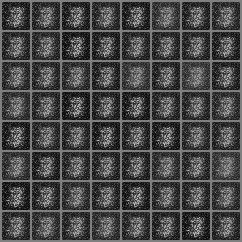
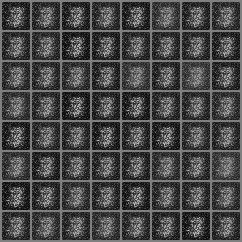
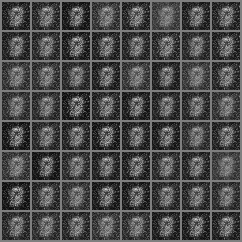
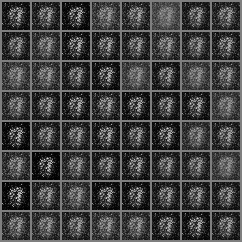
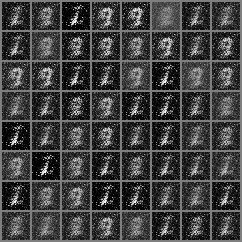
...
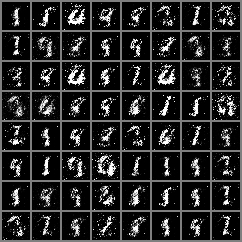
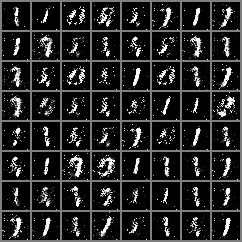
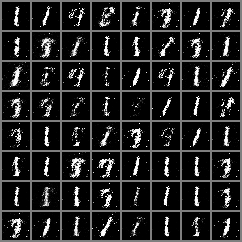
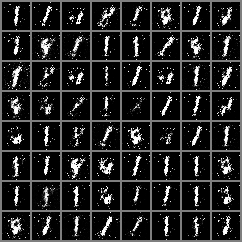
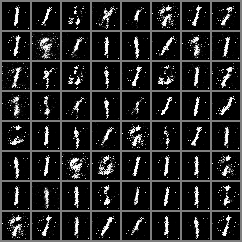

In [9]:
import numpy as np
import plotly.express as px

fake_images_grid = model.generated_images_grid

imgs = np.array([fake_images_grid[i][0].to(torch.device('cpu')).numpy() for i in fake_images_grid])
print(imgs.shape)

fig = px.imshow(imgs, animation_frame=0, binary_string=True)
fig.update_layout(
    autosize=False, 
    width=600, 
    height=800,
    sliders=[{
    "currentvalue": {
        "font": {"size": 14},
        "prefix": "Epoch:",
        "visible": True,
        "xanchor": "left"
    }
    }])

fig.show()


### t-SNE (Real images) ###

In [10]:
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np

tsne = TSNE(n_components=2, random_state=0)



mnist_tmp = MNIST(os.getcwd(), 
                  train=False, 
                  download=True, 
                  transform=transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5), (0.5))])
                  )


real_mnist_data = np.array([mnist_tmp[i][0].numpy() for i in range(10000)])
#real_mnist_data = mnist_tmp.data.numpy()
real_mnist_data = real_mnist_data.reshape(real_mnist_data.shape[0],-1)
real_mnist_label = mnist_tmp.test_labels.numpy().reshape(-1,1).astype(dtype=str)

tsne_real_mnist = tsne.fit_transform(real_mnist_data)
print(tsne_real_mnist.shape)
df_tsne_real_mnist = pd.concat([pd.DataFrame(real_mnist_label), pd.DataFrame(tsne_real_mnist)], axis=1)
df_tsne_real_mnist.columns = ['label', 'component 1', 'component 2']


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/torchvision/datasets/mnist.py:70: UserWarning:

test_labels has been renamed targets

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



(10000, 2)


In [11]:
label_order = [str(i) for i in range(10)]
colors = px.colors.qualitative.Plotly

fig = px.scatter(data_frame = df_tsne_real_mnist, x='component 1', y='component 2', color='label', color_discrete_sequence=colors, category_orders={'label':label_order})

fig.update_layout(title='t-SNE, Real MNIST', width=800, height=800)
fig.show()

### t-SNE (Real+Fake images) ###

In [12]:
fake_images_large = model.generated_images_large

fake_mnist_data = np.array([fake_images_large[i].to(torch.device('cpu')).detach().numpy() for i in fake_images_large])
print(fake_mnist_data.shape)
fake_mnist_data = fake_mnist_data.reshape(fake_mnist_data.shape[0], fake_mnist_data.shape[1], -1)
print(fake_mnist_data.shape)

(20, 1000, 1, 28, 28)
(20, 1000, 784)


In [13]:
df_tsne_fake_mnist = pd.DataFrame([])

for i in range(fake_mnist_data.shape[0]):
    print('epoch', i)
    real_fake_data = np.concatenate([real_mnist_data, fake_mnist_data[i]], axis=0)
    real_fake_label = np.concatenate([real_mnist_label, np.full((fake_mnist_data[i].shape[0],1), 'fake')], axis=0)

    tsne_real_fake_mnist = tsne.fit_transform(real_fake_data)

    epoch = np.full((tsne_real_fake_mnist.shape[0], 1), str(i))
    df_tmp = pd.concat([pd.DataFrame(epoch), pd.DataFrame(real_fake_label), pd.DataFrame(tsne_real_fake_mnist)], axis=1)

    df_tsne_fake_mnist = pd.concat([df_tsne_fake_mnist, df_tmp], axis=0)

df_tsne_fake_mnist.columns = ['Epoch', 'label', 'component 1', 'component 2']


epoch 0


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 1


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 2


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 3


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 4


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 5


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 6


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 7


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 8


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 9


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 10


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 11


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 12


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 13


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 14


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 15


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 16


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 17


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 18


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



epoch 19


/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/vols/solid/dev_ubdt/local/pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [14]:
label_order.append('fake')
colors.append('black')
fig = px.scatter(data_frame = df_tsne_fake_mnist, x='component 1', y='component 2', animation_frame='Epoch', color='label', color_discrete_sequence=colors, category_orders={'label':label_order})

fig.update_layout(title='t-SNE, Real+Fake MNIST', width=800, height=800)
fig.show()

### Histogram of the values in image ###

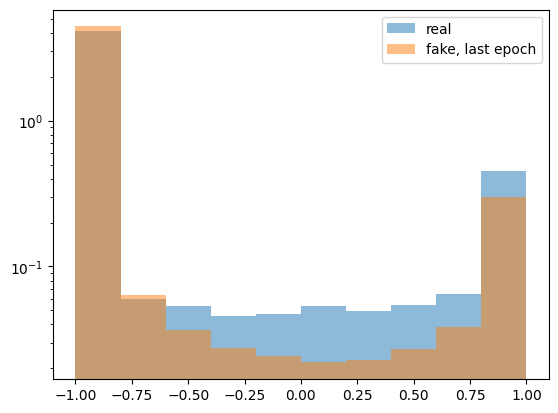

In [15]:
import matplotlib.pyplot as plt
plt.hist(real_mnist_data.flatten(), density=True, alpha=0.5, label='real')
plt.hist(fake_mnist_data[-1].flatten(), density=True, alpha=0.5, label='fake, last epoch')
plt.yscale('log')
plt.legend()
plt.show()